In [4]:
%pylab inline
import numpy as np
import scipy.io as io

Populating the interactive namespace from numpy and matplotlib


In [57]:
ImPoints = io.loadmat("data/compEx1data.mat")["x"]

Im1Pts = ImPoints[0, 0].T
Im2Pts = ImPoints[1, 0].T

Im1 = imread("data/kronan1.JPG")
Im2 = imread("data/kronan2.JPG")

(<matplotlib.figure.Figure at 0x7f49509bd4d0>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f49504068d0>)

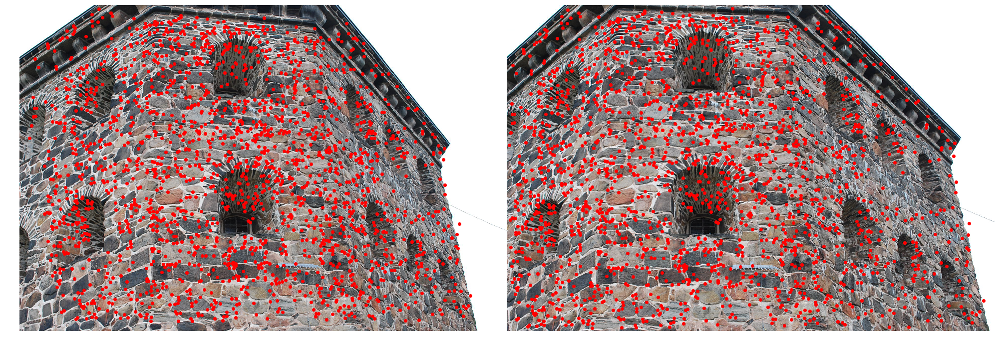

In [58]:
def DrawPoints(Im1, Im2, Pts1, Pts2):
    Im1_2 = np.hstack((Im1, Im2))
    fig = figure(figsize=(35, 20))
    ax = fig.add_subplot(1, 1, 1)
    ax.axis('off')
    ax.imshow(Im1_2)
    ax.scatter(Pts1[:, 0], Pts1[:, 1], c='r')
    ax.scatter(Pts2[:, 0] + Im1.shape[1], Pts2[:, 1], c='r')
    return fig, ax

DrawPoints(Im1, Im2, Im1Pts, Im2Pts)

Error Im1->Im2:  -0.371323148804573
Error Im2->Im1:  -0.3713231488045728


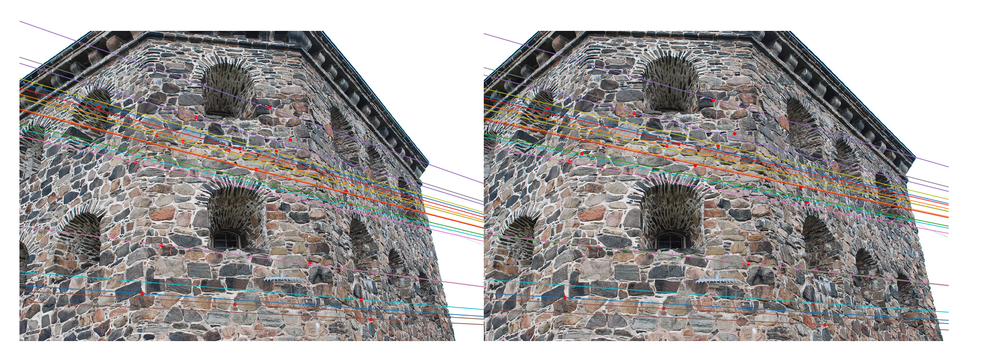

In [66]:
def DerankFundamentalMatrix(FullRankMatrix):
    FU, FS, FV = np.linalg.svd(FullRankMatrix)
    FS[-1] = 0.0
    F = np.dot(FU * FS, FV)
    return F

def ComputeFundamental(Pt1, Pt2, DerankFn=DerankFundamentalMatrix):
    U, Up = Pt1[:, 0, None], Pt2[:, 0, None]
    V, Vp = Pt1[:, 1, None], Pt2[:, 1, None]
    O = np.ones((Pt1.shape[0], 1))
    
    P1 = np.concatenate((Up, Up, Up, Vp, Vp, Vp, O, O, O), axis=1)
    P2 = np.concatenate((U, V, O, U, V, O, U, V, O), axis=1)
    
    Eqs = P1 * P2
    U, S, V = np.linalg.svd(Eqs)
    FR3 = V[-1, :].reshape((3, 3))
    return DerankFn(FR3)

def SelectPoints(N, Count = 20):
    Range = np.arange(N)
    TrainChoice = np.random.choice(Range, Count)
    TestChoice = np.random.choice(np.delete(Range, TrainChoice), Count)
    
    return TrainChoice, TestChoice

def DrawEpipolars(PointPlot, F, Pts, Offset, Width):
    Lines = np.dot(F, Pts.T)

    for i in range(Pts.shape[0]):
        A, B, C = Lines[:, i]
        Xs = [Offset, Offset + Width]
        Ys = [C / -B, (Width * A + C) / -B]
        PointPlot.plot(Xs, Ys)
        
def FundamentalInvariantError(PtsA, PtsB, F):
    PtsPair = np.hstack((PtsA, PtsB))
    Invariant = lambda Pair: Pair[:3].T.dot(F).dot(Pair[3:])

    Res = np.apply_along_axis(Invariant, 1, PtsPair)
    return np.sum(Res) / Res.shape[0]
    
TrainChosen, TestChosen = SelectPoints(Im1Pts.shape[0])
Im1Train, Im1Test = Im1Pts[TrainChosen], Im1Pts[TestChosen]
Im2Train, Im2Test = Im2Pts[TrainChosen], Im2Pts[TestChosen]
F = ComputeFundamental(Im1Train, Im2Train)

if True:
    Fig, PointsIm = DrawPoints(Im1, Im2, Im1Test, Im2Test)
    print "Error Im1->Im2: ", FundamentalInvariantError(Im1Test, Im2Test, F)
    print "Error Im2->Im1: ", FundamentalInvariantError(Im2Test, Im1Test, F.T)
    
    DrawEpipolars(PointsIm, F.T, Im2Test, 0, Im1.shape[1])
    DrawEpipolars(PointsIm, F, Im1Test, Im1.shape[1], Im2.shape[1])

Error Im1->Im2 (normalized):  -0.0149501613576821
Error Im2->Im1 (normalized):  -0.014950161357682146
Error Im1->Im2 (denormalized):  0.03755649382680766
Error Im2->Im1 (denormalized):  0.037556493826807744


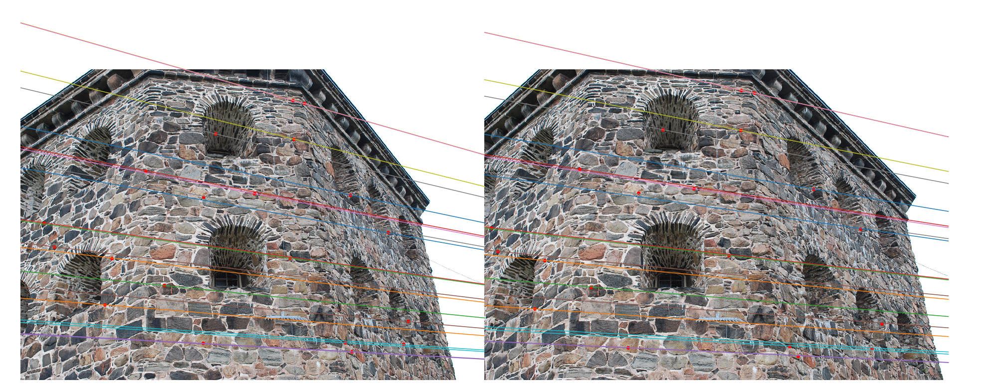

In [64]:
def NormalizeStdDevWithZeroCenter(Pts, TargetStdDev):
    Transform = np.identity(3)
    Mean = np.mean(Pts, axis=0)
    StdDev = np.std(Pts - Mean, axis=0)
    
    SX = TargetStdDev / StdDev[0]
    SY = TargetStdDev / StdDev[1]
    TX = -Mean[0] * SX
    TY = -Mean[1] * SY
    
    Transform[[0, 1], [2, 2]] = TX, TY
    Transform[[0, 1], [0, 1]] = SX, SY
    
    return Transform
    
def ApplyTransform(Pts, Transform):
    return np.dot(Transform, Pts.T).T

T1 = NormalizeStdDevWithZeroCenter(Im1Pts, np.sqrt(2))
T2 = NormalizeStdDevWithZeroCenter(Im2Pts, np.sqrt(2))

Im1PtsNorm = ApplyTransform(Im1Pts, T1)
Im2PtsNorm = ApplyTransform(Im2Pts, T2)

Im1NormTrain, Im1NormTest = Im1PtsNorm[TrainChosen], Im1PtsNorm[TestChosen]
Im2NormTrain, Im2NormTest = Im2PtsNorm[TrainChosen], Im2PtsNorm[TestChosen]

FNorm = ComputeFundamental(Im1NormTrain, Im2NormTrain)
FDenorm = T2.T.dot(FNorm).dot(T1)

if True:
    Fig, PointsIm = DrawPoints(Im1, Im2, Im1Test, Im2Test)
    print "Error Im1->Im2 (normalized): ", FundamentalInvariantError(Im1NormTest, Im2NormTest, FNorm)
    print "Error Im2->Im1 (normalized): ", FundamentalInvariantError(Im2NormTest, Im1NormTest, FNorm.T)
    print "Error Im1->Im2 (denormalized): ", FundamentalInvariantError(Im1Test, Im2Test, FDenorm)
    print "Error Im2->Im1 (denormalized): ", FundamentalInvariantError(Im2Test, Im1Test, FDenorm.T)
    
    DrawEpipolars(PointsIm, FDenorm.T, Im2Test, 0, Im1.shape[1])
    DrawEpipolars(PointsIm, FDenorm, Im1Test, Im1.shape[1], Im2.shape[1])

Error Im1->Im2 (from essential):  0.004586957151348673
Error Im2->Im1 (from essential):  0.004586957151348671


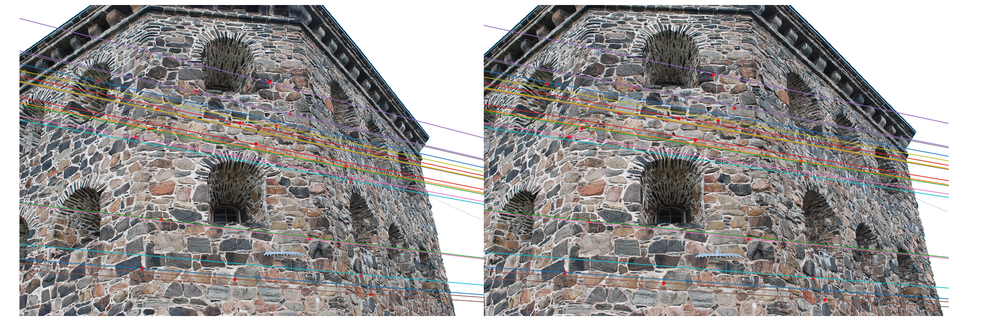

In [71]:
K = io.loadmat("data/compEx3data.mat")['K']
KInv = np.linalg.inv(K)
Im1PointsK = ApplyTransform(Im1Pts, KInv)
Im2PointsK = ApplyTransform(Im2Pts, KInv)

def DerankEssentialMatrix(FullRankMatrix):
    EU, ES, EV = np.linalg.svd(FullRankMatrix)
    ES = np.array([((ES[0] + ES[1]) / 2), ((ES[0] + ES[1]) / 2), 0.0])
    
    return np.dot(EU * ES, EV)

def ComputeEssential(Pt1, Pt2):
    return ComputeFundamental(Pt1, Pt2, DerankEssentialMatrix)

E = ComputeEssential(Im1PointsK, Im2PointsK)
FfromE = KInv.T.dot(E).dot(KInv)

if True:
    Fig, PointsIm = DrawPoints(Im1, Im2, Im1Test, Im2Test)
    print "Error Im1->Im2 (from essential): ", FundamentalInvariantError(Im1Test, Im2Test, FfromE)
    print "Error Im2->Im1 (from essential): ", FundamentalInvariantError(Im2Test, Im1Test, FfromE.T)
    
    DrawEpipolars(PointsIm, FfromE.T, Im2Test, 0, Im1.shape[1])
    DrawEpipolars(PointsIm, FfromE, Im1Test, Im1.shape[1], Im2.shape[1])

In [78]:
def P2CandidatesFromE(E):
    EU, ES, EV = np.linalg.svd(E)

    # There are four possible candidates for projection matrix for the second camera:
    W = np.array([
        [0.0, -1.0, 0.0],
        [1.0,  0.0, 0.0],
        [0.0,  0.0, 1.0]
    ])    
    U3 = EU[:, 2]
    
    return [
        np.hstack((EU.dot(W).dot(EV), U3[:, None])),
        np.hstack((EU.dot(W).dot(EV), -U3[:, None])),
        np.hstack((EU.dot(W.T).dot(EV), U3[:, None])),
        np.hstack((EU.dot(W.T).dot(EV), -U3[:, None]))
    ]

# We assume the first camera is positioned at (0, 0, 0) without rotation.
P1 = np.hstack((np.identity(3), np.array([[0, 0, 0]]).T)) 
P2Candidates = P2CandidatesFromE(E)

def Triangulate(P1, P2, Pt1, Pt2):
    Pt1 /= Pt1[2, None]
    Pt2 /= Pt2[2, None]
    
    Col1 = Pt1[0] * P1[2, :] - P1[0, :]
    Col2 = Pt1[1] * P1[2, :] - P1[1, :]
    Col3 = Pt2[0] * P2[2, :] - P2[0, :]
    Col4 = Pt2[1] * P2[2, :] - P2[1, :]
    
    A = np.vstack((Col1, Col2, Col3, Col4))
    
    U, S, V = np.linalg.svd(A)
    Res = V[-1, :]
    return Res

def BestP2Candidate(Im1Points, Im2Points, P1, P2Candidates):
    # The general idea: From all P2 candidates there is only one candidate 
    # that represents a camera looking at points.
    P2 = None
    AheadOfCamera = [0 for i in range(len(P2Candidates))]
    PointPairs = np.hstack((Im1Points, Im2Points))
    
    for Index, P2 in enumerate(P2Candidates):
        TriangulatePoint = lambda Pair: Triangulate(P1, P2, Pair[:3], Pair[3:])
        TriangulatedPoints = np.apply_along_axis(TriangulatePoint, 1, PointPairs)
        TriangulatedPoints /= TriangulatedPoints[-1, None]
        
        # Project points with Camera #1:
        PointsProjectedP1 = ApplyTransform(TriangulatedPoints, P1)
        
        # Project points with Camera #2:
        PointsProjectedP2 = ApplyTransform(TriangulatedPoints, P2)
        
        # We take only points that are projected in front of both cameras:
        ValidPointsCount = TriangulatedPoints[(PointsProjectedP1[:, 2] > 0) & (PointsProjectedP2[:, 2] > 0)].shape[0]
        AheadOfCamera[Index] = ValidPointsCount
    
    BestCandidateIndex = 0
    for Index, PointsVisibleCount in enumerate(AheadOfCamera):
        if PointsVisibleCount > AheadOfCamera[BestCandidateIndex]:
            BestCandidateIndex = Index
    
    return P2Candidates[BestCandidateIndex]

Im1KTrain = Im1PointsK[TrainChosen]
Im2KTrain = Im2PointsK[TrainChosen]

P2 = BestP2Candidate(Im1KTrain, Im2KTrain, P1, P2Candidates)
print "Found valid P2 projection:\n", P2

AllPoints = [Triangulate(P1, P2, p1, p2) for (p1, p2) in zip(Im1PointsK, Im2PointsK)]
AllPoints = np.array(AllPoints)
AllPoints /= AllPoints[:, 3, None]

Found valid P2 projection:
[[ 0.99438445  0.02933304  0.10168156 -0.92229092]
 [-0.03112361  0.99938639  0.01606773 -0.14220198]
 [-0.10114785 -0.01914219  0.99468723 -0.35938565]]


In [79]:
from plyfile import PlyData, PlyElement
XX = AllPoints
points = np.array(zip(XX[:,0].ravel(), XX[:,1].ravel(), XX[:,2].ravel()),dtype=[('x','f4'), ('y', 'f4'),('z', 'f4')])
el = PlyElement.describe(points, 'vertex')
PlyData([el]).write('pc.ply') 

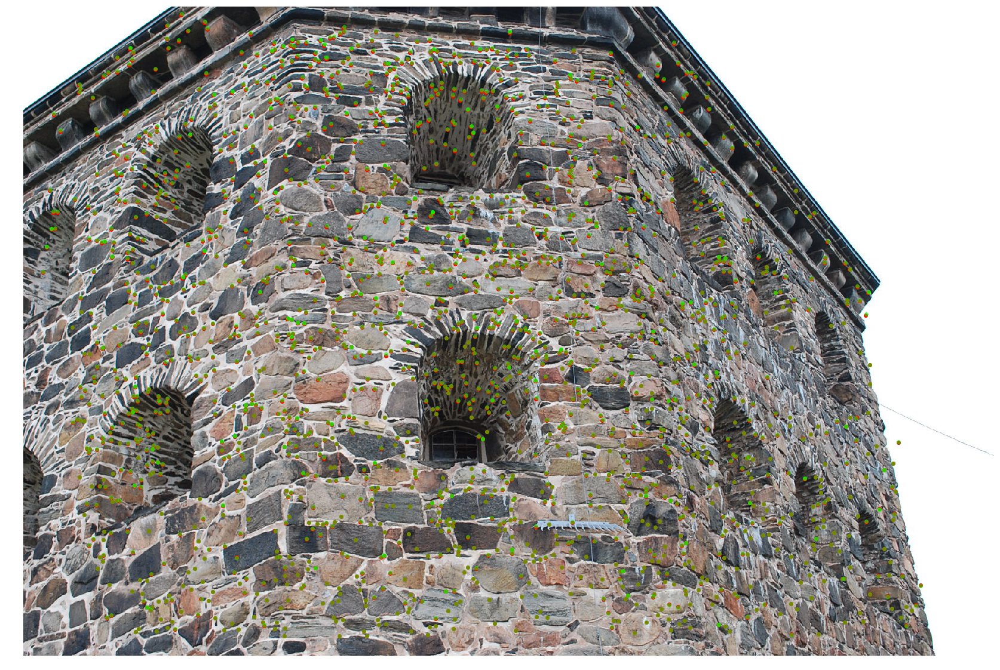

In [81]:
P1F = np.dot(K, P1)
P2F = np.dot(K, P2)

Im1Reproj = np.dot(P1F, AllPoints.T).T
Im2Reproj = np.dot(P2F, AllPoints.T).T
Im1Reproj /= Im1Reproj[:, 2, None]
Im2Reproj /= Im2Reproj[:, 2, None]

reprojim1 = figure(figsize=(35, 20))
ax_im1 = reprojim1.add_subplot(1, 1, 1)
ax_im1.axis('off')
ax_im1.imshow(Im1)
ax_im1.scatter(Im1Reproj[:, 0], Im1Reproj[:, 1], c=(1.0, 0.0, 0.0, 1.0))
ax_im1.scatter(Im1Pts[:, 0], Im1Pts[:, 1], c=(0.0, 1.0, 0.0, 0.5))

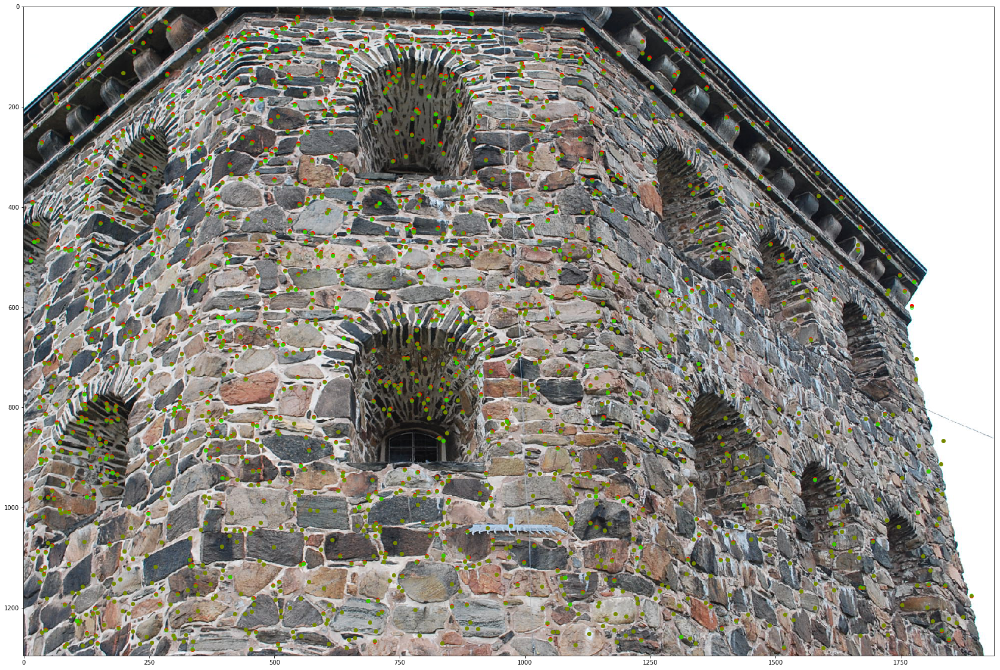

In [82]:
reprojim2 = figure(figsize=(35, 20))
ax_im2 = reprojim2.add_subplot(1, 1, 1)
ax_im2.imshow(Im2)
ax_im2.scatter(Im2Reproj[:, 0], Im2Reproj[:, 1], c=(1.0, 0.0, 0.0, 1.0))
ax_im2.scatter(Im2Pts[:, 0], Im2Pts[:, 1], c=(0.0, 1.0, 0.0, 0.5))

In [83]:
def reprojectionError(realPts, projectedPts):
    return np.sum(np.sqrt((realPts - projectedPts) ** 2))

print "Reprojection error for Im1 = ", reprojectionError(Im1Pts, Im1Reproj)
print "Reprojection error for Im2 = ", reprojectionError(Im2Pts, Im2Reproj)

Reprojection error for Im1 =  2339.607149397536
Reprojection error for Im2 =  2406.763334102232


In [93]:
r = Im1[Im1Pts[:, 1].astype(np.uint), Im1Pts[:, 0].astype(np.uint), 0]
g = Im1[Im1Pts[:, 1].astype(np.uint), Im1Pts[:, 0].astype(np.uint), 1]
b = Im1[Im1Pts[:, 1].astype(np.uint), Im1Pts[:, 0].astype(np.uint), 2]

points = np.array(zip(XX[:,0].ravel(), XX[:,1].ravel(), XX[:,2].ravel(), r.ravel(), g.ravel(), b.ravel()),dtype=[('x','f4'), ('y', 'f4'),('z', 'f4'), ('red', 'u1'), ('green', 'u1'),('blue', 'u1')])
el = PlyElement.describe(points, 'vertex')
PlyData([el]).write('pccolored.ply') 
